# Spatial Transcriptomics Cluster Validation for HM-OT

In [ ]:
import scanpy as sc
import anndata as ad
import numpy as np

import sys
import os
import importlib
os.environ["CUBLAS_WORKSPACE_CONFIG"] = ":4096:8"
import torch
sys.path.append(os.path.abspath(".."))

import src.HiddenMarkovOT as HiddenMarkovOT
import src.utils.util_LR as util_LR
from src.utils.util_LR import convert_adata
import src.plotting as plotting


In [ ]:
import random

def seed_everything(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    os.environ['PYTHONHASHSEED'] = str(seed)
    return

seed_everything(42)

timepoints = [ 'E11.5', 'E12.5', 'E13.5'] 


In [ ]:
# Comment this cell out to regenerate the adata pairs with PCA applied
"""
filehandles_embryo_adata = [
                            '/scratch/gpfs/ph3641/mouse_embryo/E11.5_E1S1.MOSTA.h5ad', \
                            '/scratch/gpfs/ph3641/mouse_embryo/E12.5_E1S1.MOSTA.h5ad', \
                            '/scratch/gpfs/ph3641/mouse_embryo/E13.5_E1S1.MOSTA.h5ad'
                            ]

# Load adatas and set count layer and timepoints
print('Loading mouse-embryo AnnDatas')
adatas = []
for i, fh in enumerate(filehandles_embryo_adata):
    adata = sc.read_h5ad(fh)
    adata.X = adata.layers['count']
    adata.obs['timepoint'] = [timepoints[i]] * adata.shape[0]
    adatas.append(adata)

# Find intersection of genes across all adatas
common_genes = set(adatas[0].var.index)
for adata in adatas[1:]:
    common_genes &= set(adata.var.index)
common_genes = list(common_genes)

# Subset each adata to the common genes
adatas = [adata[:, common_genes] for adata in adatas]
adata_pairs = []

print('Starting PCA')

# Compute pairwise PCA (so it's scalable) for each AnnData (t, t+1)
for i in range(len(adatas) - 1):
    ad1, ad2 = adatas[i], adatas[i+1]
    t1, t2 = timepoints[i], timepoints[i+1]
    
    # 1) Normalize + log-transform both slices independently
    joint = ad.concat([ad1, ad2], join='inner')
    sc.pp.normalize_total(joint)
    sc.pp.log1p(joint)
    sc.pp.pca(joint, n_comps=30, svd_solver='arpack', random_state=42)
    # Free up memory by clearing X and heavy layers
    joint.X = None
    if 'count' in joint.layers:
        del joint.layers['count']
    adata_pairs.append(joint)

print('PCA Finished!')


save_dir = '/scratch/gpfs/ph3641/mouse_embryo/pca_pairs/'
os.makedirs(save_dir, exist_ok=True)

# Save pairs
for i, joint in enumerate(adata_pairs):
    fname = f'{save_dir}/embryo_pair_{timepoints[i]}_{timepoints[i+1]}.h5ad'
    joint.write(fname)
"""


In [ ]:
# Load precomputed PCA-transformed AnnData pairs

filehandles_pca_pairs = [
    '/scratch/gpfs/ph3641/mouse_embryo/pca_pairs/embryo_pair_E11.5_E12.5.h5ad',
    '/scratch/gpfs/ph3641/mouse_embryo/pca_pairs/embryo_pair_E12.5_E13.5.h5ad'
]

adata_pairs = [sc.read_h5ad(fh) for fh in filehandles_pca_pairs]

In [ ]:

from src.utils.util_LR import convert_adata_pairwise

# Set torch device (GPU if available)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Convert AnnData in HM-OT ready factors
C_factors_sequence, A_factors_sequence, Qs, labels, rank_list, spatial_list = convert_adata_pairwise(adata_pairs,
                                                                                    timepoints=timepoints,
                                                                                     timepoint_key = 'timepoint',
                                                                                     replicate_key = 'embryo_id',
                                                                                     feature_key = 'X_pca',
                                                                                     cell_type_key = 'annotation',
                                                                                     spatial = True,
                                                                                     spatial_key = ['x_loc', 'y_loc'],
                                                                                     fallback_spatial_key = 'spatial',
                                                                                     dist_eps = 0.02,
                                                                                     dist_rank = 100,
                                                                                     dist_rank_2 = 50,
                                                                                     device = device,
                                                                                    normalize=True
                                                                                )


In [ ]:
print(f'{Qs[0].shape[1]} to {Qs[1].shape[1]} cell-types in annotation')

In [7]:
seed_everything(123)

joint = adata_pairs[0]

tp1, tp2 = joint.obs['timepoint'].unique()

mask1 = joint.obs['timepoint'] == tp1
mask2 = joint.obs['timepoint'] == tp2
X1 = joint[mask1].obsm['X_pca']
X2 = joint[mask2].obsm['X_pca']

from sklearn.cluster import KMeans


k1, k2 = 24, 28

labels1 = KMeans(n_clusters=k1, random_state=42).fit_predict(X1)
labels2 = KMeans(n_clusters=k2, random_state=42).fit_predict(X2)

# build prop tensors
def get_prop(labels, k):
    counts = np.bincount(labels, minlength=k)
    return torch.tensor(counts / counts.sum(), dtype=torch.float32)

p1 = get_prop(labels1, k1)  
p2 = get_prop(labels2, k2)



In [8]:
print(p1.shape)
print(p2.shape)
print(p1)
print(p2)

proportions = [p1.to(device), p2.to(device)]


torch.Size([24])
torch.Size([28])
tensor([0.0259, 0.0815, 0.0475, 0.0401, 0.0404, 0.0517, 0.0466, 0.0109, 0.0230,
        0.0282, 0.0190, 0.1014, 0.0565, 0.0362, 0.0095, 0.0416, 0.0318, 0.0189,
        0.0283, 0.0218, 0.0272, 0.0686, 0.0926, 0.0507])
tensor([0.0492, 0.0499, 0.0222, 0.0230, 0.0582, 0.0387, 0.0354, 0.0378, 0.0378,
        0.0487, 0.0446, 0.0120, 0.0217, 0.0208, 0.0192, 0.0275, 0.0358, 0.0408,
        0.0116, 0.0264, 0.0573, 0.0621, 0.0543, 0.0654, 0.0197, 0.0215, 0.0365,
        0.0220])


In [9]:
import src.utils.clustering as clustering
from sklearn.metrics import adjusted_mutual_info_score as ami
from sklearn.metrics import adjusted_rand_score as ari

seed_everything(42)
num_iter = 10
running_min_cost = torch.inf

for i in range(num_iter):

    # Set a replicable random seed
    gen = torch.Generator(device=device)
    gen.manual_seed(i + 42)
    
    # Initialize HM-OT
    hmot_u = HiddenMarkovOT.HM_OT(
                                rank_list = [(p1.shape[0], p2.shape[0])],
                                tau_in = 1e-3,
                                tau_out = 1e-3,
                                gamma = 80,
                                max_iter = 200,
                                min_iter = 200,
                                device=device,
                                alpha = 0.9999,
                                dtype = torch.float32,
                                printCost = False,
                                returnFull = False,
                                initialization = 'Full',
                                proportions=proportions,
                                generator=gen,
                                max_inner_iters_R = 300
                               )
    
    hmot_u.gamma_smoothing(C_factors_sequence[:-1],
                         A_factors_sequence[:-1],
                         Qs_IC = [None, None],
                         Qs_freeze = [False, False],
                        warmup = False
                        )
    
    if hmot_u.compute_total_cost(C_factors_sequence[:-1], A_factors_sequence[:-1]) < running_min_cost:
        hmot_unsup = hmot_u


# Plotting results
Qs_ann = [Q.cpu().numpy() for Q in Qs][:-1]

Qs_hmot_unsup = [Q.cpu().numpy() for Q in hmot_unsup.Q_gammas]
Ts_hmot_unsup = [T.cpu().numpy() for T in hmot_unsup.T_gammas]

clusterings_ann = clustering.max_likelihood_clustering(Qs_ann, mode='standard')

clusterings_hmot = clustering.reference_clustering(
                Qs = Qs_hmot_unsup,
                Ts = Ts_hmot_unsup,
                reference_index = 0
                )

for i, gt_types in enumerate(clusterings_ann):
    
    print(f'slice {i}')
    
    pred_types = clusterings_hmot[i]
    
    print(f"ami of predictions: {ami(gt_types, pred_types):.3f} for slice {i} (gamma)")
    print(f"ari of predictions: {ari(gt_types, pred_types):.3f} for slice {i} (gamma)")




Iteration: 0
Iteration: 25
Iteration: 50
Iteration: 75
Iteration: 100
Iteration: 125
Iteration: 150
Iteration: 175
Final Cost: 2.4116608710045284e-09; cost_GW: 4.1668532513305934e-10, cost_W: 1.9950173737015575e-05
Iteration: 0
Iteration: 25
Iteration: 50
Iteration: 75
Iteration: 100
Iteration: 125
Iteration: 150
Iteration: 175
Final Cost: 2.431669532398928e-09; cost_GW: 4.378186146958285e-10, cost_W: 1.993894693441689e-05
Iteration: 0
Iteration: 25
Iteration: 50
Iteration: 75
Iteration: 100
Iteration: 125
Iteration: 150
Iteration: 175
Final Cost: 2.409031862882216e-09; cost_GW: 4.278200294027812e-10, cost_W: 1.9812547179753892e-05
Iteration: 0
Iteration: 25
Iteration: 50
Iteration: 75
Iteration: 100
Iteration: 125
Iteration: 150
Iteration: 175
Final Cost: 2.4221369354648914e-09; cost_GW: 4.296273892201441e-10, cost_W: 1.992552643059753e-05
Iteration: 0
Iteration: 25
Iteration: 50
Iteration: 75
Iteration: 100
Iteration: 125
Iteration: 150
Iteration: 175
Final Cost: 2.3859700881700974e-

In [ ]:
import pickle
'''
os.makedirs("matrices", exist_ok=True)

# Save using pickle
with open("matrices/spatial_list.pkl", "wb") as f:
    pickle.dump(spatial_list, f)
with open("matrices/Qs_hmot_unsup.pkl", "wb") as f:
    pickle.dump(Qs_hmot_unsup, f)
with open("matrices/Ts_hmot_unsup.pkl", "wb") as f:
    pickle.dump(Ts_hmot_unsup, f)
'''

In [ ]:
import pickle
# Load using pickle
with open("matrices/spatial_list.pkl", "rb") as f:
    spatial_list = pickle.load(f)
with open("matrices/Qs_hmot_unsup.pkl", "rb") as f:
    Qs_hmot_unsup = pickle.load(f)
with open("matrices/Ts_hmot_unsup.pkl", "rb") as f:
    Ts_hmot_unsup = pickle.load(f)

Qs_ann = [Q.cpu().numpy() for Q in Qs][:-1]

clusterings_ann = clustering.max_likelihood_clustering(Qs_ann, mode='standard')

clusterings_hmot = clustering.reference_clustering(
                Qs = Qs_hmot_unsup,
                Ts = Ts_hmot_unsup,
                reference_index = 0
                )

In [ ]:
import importlib
importlib.reload(plotting)

# Visualize the transfer from time 1 to time 2
plotting.plot_clusters_from_QT(spatial_list[:-1], Qs_hmot_unsup,
                               Ts_hmot_unsup, None, clustering_type='reference',
                               reference_index=0, flip=True, dotsize=10,
                              save_name='ME_unsupervised_spatial_E115_E125.svg',
                              key_dotsize=0.3)


In [ ]:
plotting.plot_clusters_from_QT(spatial_list[:-1], Qs_hmot_unsup,
                               Ts_hmot_unsup, None, flip=True, dotsize=10,
                              save_name='ME_unsupervised_spatial_E115_E125_ML.svg',
                              key_dotsize=0.3)

In [ ]:
plotting.diffmap_from_QT_sankey(Qs_hmot_unsup, Ts_hmot_unsup, None,
                        save_name='ME_unsupervised_spatial_E115_E125_diffmap.svg',
                        dsf=0.1)

In [20]:
import pandas as pd


adata_11_5 = sc.read_h5ad('/scratch/gpfs/ph3641/mouse_embryo/E11.5_E1S1.MOSTA.h5ad')
adata_12_5 = sc.read_h5ad('/scratch/gpfs/ph3641/mouse_embryo/E12.5_E1S1.MOSTA.h5ad')

clus = clusterings_hmot

clus_idx = [1]

indices1_ann = np.where(np.isin(clusterings_ann[0], clus_idx))[0]
indices2_ann = np.where(np.isin(clusterings_ann[1], clus_idx))[0]

Q1 = Qs_ann[0]
Q2 = Qs_ann[1]

Q1_brain_ann = Q1[indices1_ann, :][:, clus_idx]
Q2_brain_ann = Q2[indices2_ann, :][:, clus_idx]

spatial_brain1_ann = spatial_list[0][indices1_ann]
spatial_brain2_ann = spatial_list[1][indices2_ann]

clus1_brain = clus[0][indices1_ann]
clus2_brain = clus[1][indices2_ann]

# HM-OT Brain Types
plotting.plot_clustering_list(
    spatial_list=[spatial_brain1_ann, spatial_brain2_ann],
    clustering_list=[clus1_brain, clus2_brain],
    clustering_type='reference',
    dotsize=20,
    flip=True,
    key_dotsize=0.3
)

clus1_brain_ann = clusterings_ann[0][indices1_ann]
clus2_brain_ann = clusterings_ann[1][indices2_ann]

# Annotated "Brain"
plotting.plot_clustering_list(
    spatial_list=[spatial_brain1_ann, spatial_brain2_ann],
    clustering_list=[clus1_brain_ann, clus2_brain_ann],
    clustering_type='reference',
    dotsize=20,
    flip=True
)


# Annotate brain clusters
adata_11_5.obs['brain_cluster'] = pd.NA
adata_12_5.obs['brain_cluster'] = pd.NA

adata_11_5.obs.loc[adata_11_5.obs.index[indices1_ann], 'brain_cluster'] = clus1_brain
adata_12_5.obs.loc[adata_12_5.obs.index[indices2_ann], 'brain_cluster'] = clus2_brain

adata_11_5.obs.loc[adata_11_5.obs.index[indices1_ann], 'brain_cluster_ann'] = clus1_brain_ann
adata_12_5.obs.loc[adata_12_5.obs.index[indices2_ann], 'brain_cluster_ann'] = clus2_brain_ann

adata_11_5_brain = adata_11_5[indices1_ann].copy()
adata_12_5_brain = adata_12_5[indices2_ann].copy()

# Cluster labels should be treated as categorical
adata_11_5_brain.obs['brain_cluster'] = adata_11_5_brain.obs['brain_cluster'].astype('category')
adata_12_5_brain.obs['brain_cluster'] = adata_12_5_brain.obs['brain_cluster'].astype('category')

adata_11_5_brain.obs['brain_cluster_ann'] = adata_11_5_brain.obs['brain_cluster_ann'].astype('category')
adata_12_5_brain.obs['brain_cluster_ann'] = adata_12_5_brain.obs['brain_cluster_ann'].astype('category')


In [21]:
import matplotlib.pyplot as plt
import clustering_validation as cv

_common_cluster_labels = np.intersect1d(np.unique(clus1_brain), 
                                         np.unique(clus2_brain))
common_cluster_labels = []

# Basic filtering so number of co-occurring cells is significant and gives enough statistical power
thres = 500

for cluster_label in _common_cluster_labels:
    idx1 = np.where(clus1_brain == cluster_label)
    #idx2 = np.where(clus2_brain == cluster_label)
    if len(clus1_brain[idx1]) > thres: #and len(clus2_brain[idx2]) > thres:
        common_cluster_labels.append(cluster_label)

common_cluster_labels = np.array(common_cluster_labels)

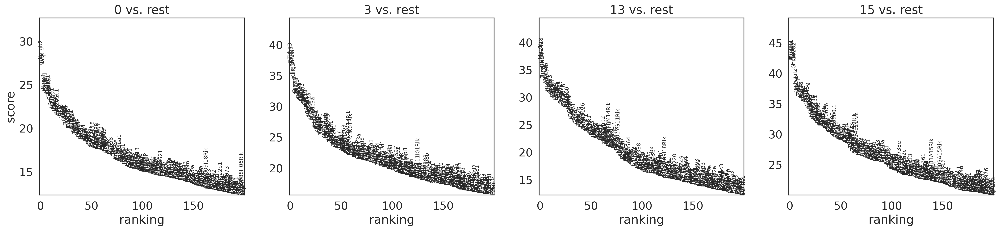

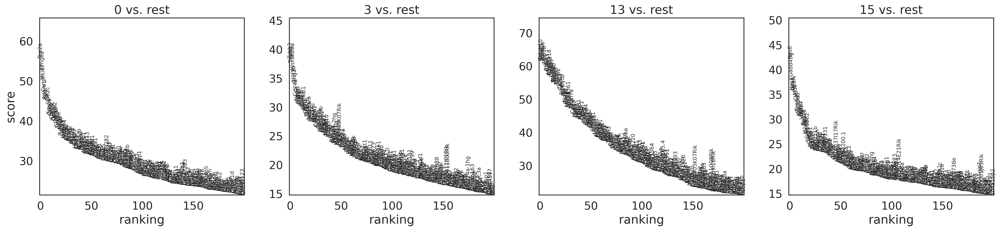


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [22]:
import clustering_validation as cv
import importlib
importlib.reload(cv)

prolif_genes = ['Sox2',
                  'Mki67',
                  'Dek',
                  'Ccnd1',
                  'Eif4g1',
                  'Top2a',
                  'Tpx2',
                  'Ube2c',
                   'Ezh2',
                   'Hmga2'
               ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = prolif_genes
)


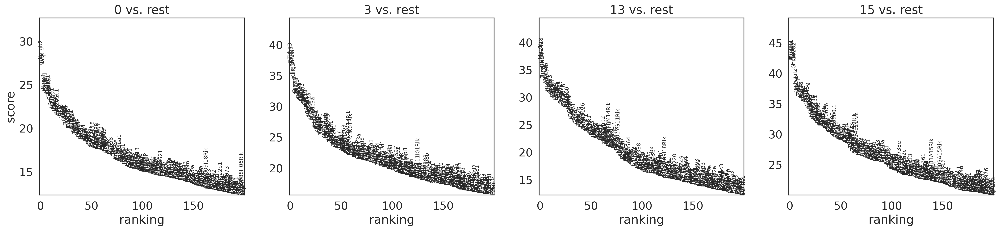

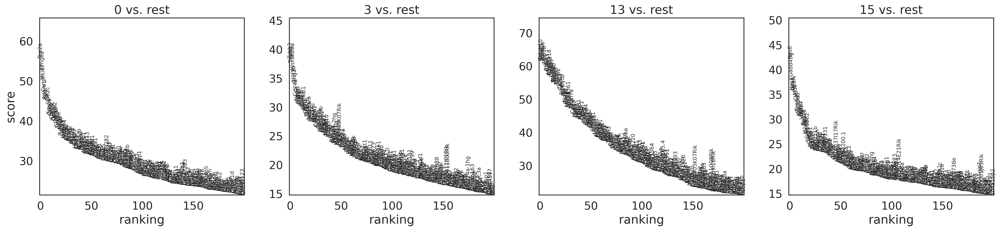


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [23]:

int_genes = ['Hes5',
            'Hes6',
            'Fabp7',
            'Vim',
            'Gadd45g',
            'Id3',
            'Tead2',
             'Tcf3'
            ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = int_genes
)


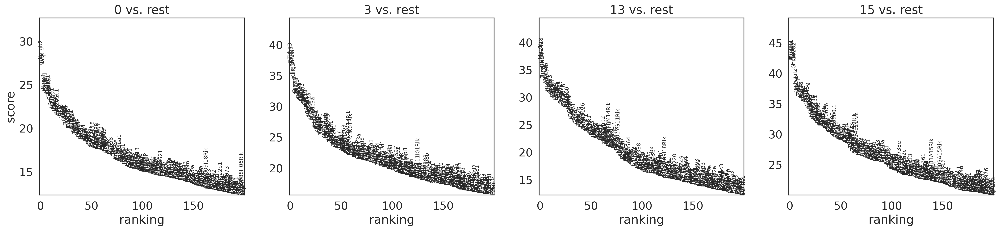

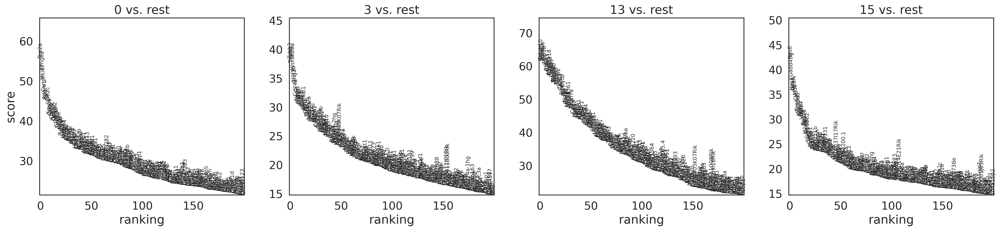


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [24]:

int_genes2 = ['Cd24a',
            'Stmn1/2',
            'Sox11',
             'Nsg1',
             'Bex2',
              'Elavl3',
              'Map2',
              'Dcx'
            ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = int_genes2
)


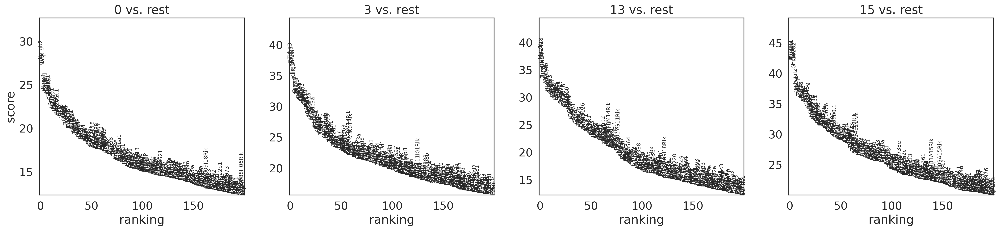

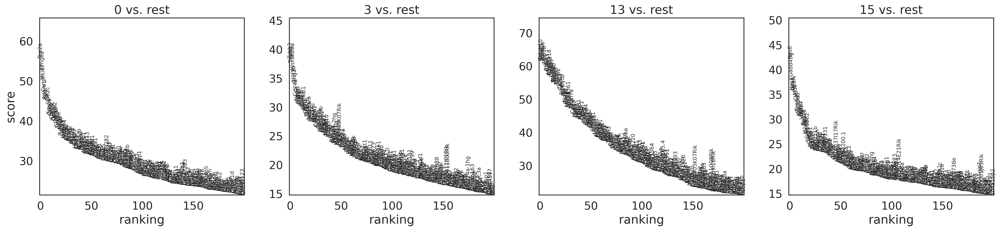


=== Cluster 0 ===
Intersection genes (115):
 ['Adgrv1', 'Anp32b', 'Anp32e', 'Camk1d', 'Cbx5', 'Ccna2', 'Ccnb1', 'Ccnb2', 'Ccnd1', 'Cdc20', 'Cdca3', 'Cdca7', 'Cdca8', 'Cdv3', 'Cenpa', 'Cenpe', 'Cenpf', 'Cenpw', 'Chd7', 'Ckap5', 'Cks2', 'Clic4', 'Ctnna1', 'Dek', 'Eif4g1', 'Ezh2', 'G3bp1', 'Gli3', 'Gnai2', 'Gpc6', 'Grb10', 'Hells', 'Hjurp', 'Hmga2', 'Hmgb1', 'Hmgb2', 'Hnrnpf', 'Hnrnpm', 'Hnrnpu', 'Hsp90b1', 'Id3', 'Igf2bp1', 'Ipo5', 'Kdm1b', 'Kif15', 'Kif23', 'Knstrn', 'Kpnb1', 'Larp7', 'Ldha', 'Lmnb1', 'Mcm3', 'Mcm5', 'Mcm6', 'Mcm7', 'Mest', 'Mki67', 'Msi2', 'Nap1l1', 'Nasp', 'Ncapd2', 'Ncl', 'Nde1', 'Nedd4', 'Nop58', 'Npas3', 'Npm1', 'Nrarp', 'Nucks1', 'Numa1', 'Oraov1', 'Pabpc1', 'Paics', 'Pclaf', 'Pcm1', 'Pcna', 'Phgdh', 'Phip', 'Pimreg', 'Pnn', 'Prrc2c', 'Ptbp1', 'Ptn', 'Qk', 'Rdx', 'Rps2', 'Rrm1', 'Rrm2', 'Set', 'Setbp1', 'Smc2', 'Smc4', 'Sox2', 'Sox9', 'Spata13', 'Spc24', 'Srsf1', 'Tacc3', 'Tcf4', 'Tead2', 'Tmpo', 'Top2a', 'Tpx2', 'Tuba1b', 'Tuba1c', 'Ube2c', 'Uhrf1', 'Usp1', 'Vim

In [25]:

mat_genes = ['Nefm',
             'Tubb3',
             'Ina',
            'Map2',
             'Mapt',
             'Nefl',
             'Elavl3',
             'Uchl1',
             'mt-Co1',
             'Rab3a'
            ]

J1 = cv.get_Jaccard_Table(
    adata_11_5_brain, adata_12_5_brain,
    clus1_brain, clus2_brain,
    cluster_label='brain_cluster',
    n_top_genes=200,
    overlap_lst=common_cluster_labels,
    print_DE=True,
    genes_to_print = mat_genes
)


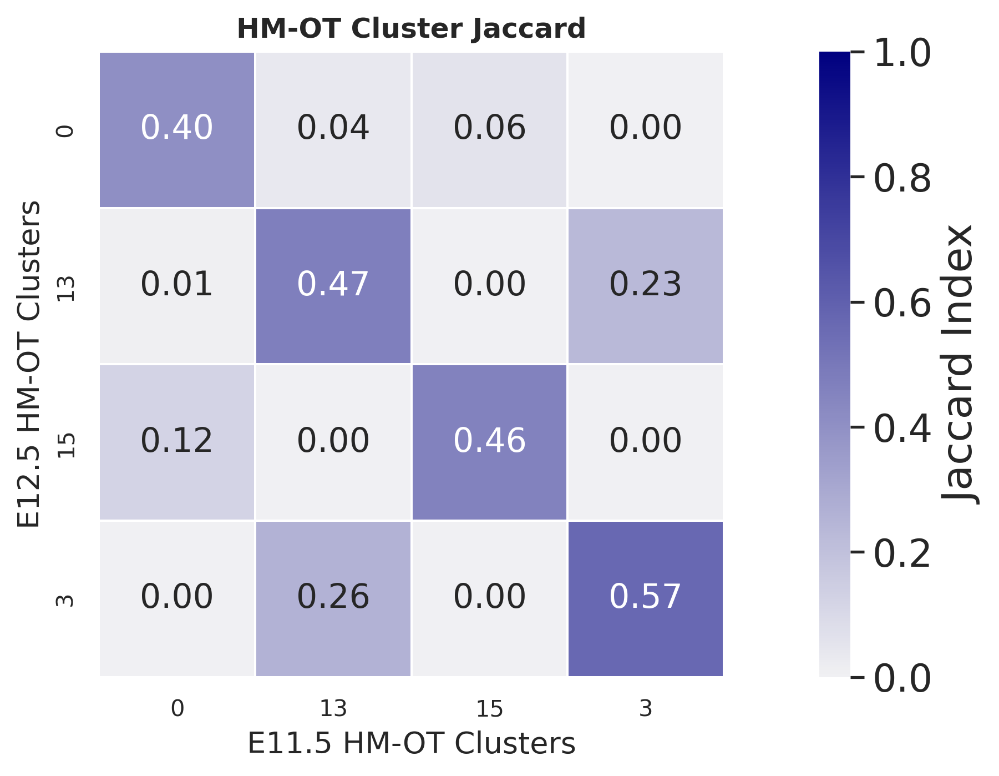

<Figure size 640x480 with 0 Axes>

In [16]:


fig, ax1 = plt.subplots(1, 1, figsize=(12, 5), dpi=300)

cv.plot_jaccard_matrix(J1, ax1, annot_text=True, title="HM-OT Cluster Jaccard",
                       x_lab='E11.5 HM-OT Clusters', y_lab='E12.5 HM-OT Clusters')

plt.tight_layout()
plt.show()

ax1.set_title("HM-OT Cluster Jaccard")

plt.tight_layout()
plt.show()


In [ ]:
import scanpy as sc

# Define marker genes to visualize (adjust as needed)
marker_genes = ['Sox2', 'Eomes', 'Bcl11b', 'Satb2']  # Proliferation → Intermediate progenitors → Deep → Upper neurons

# Check which markers exist in data
available_markers = [g for g in marker_genes if g in adata_11_5_brain.var_names]
print(f"Available markers: {available_markers}")

# Optionally set resolution
dpi = 150

# Plot spatial expression on E11.5
sc.pl.spatial(
    adata_11_5_brain,
    color=available_markers,
    ncols=2,
    spot_size=1,
    cmap='magma',
    size=1.2,
    title=[f"{g} (E11.5)" for g in available_markers],
    show=True,
    save='E11_5.pdf',
    frameon=False,
)

# Plot spatial expression on E12.5
sc.pl.spatial(
    adata_12_5_brain,
    color=available_markers,
    ncols=2,
    spot_size=1,
    cmap='magma',
    size=1.2,
    title=[f"{g} (E12.5)" for g in available_markers],
    show=True,
    save='E13_5.pdf',
    frameon=False,
)